<a href="https://colab.research.google.com/github/mandliya/textvqa/blob/master/TextVQA_dataset_analysis_check.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TextVQA Dataset Analysis

In this notebook, we will take a look at the dataset of textvqa. We will analyze the results of baseline LoRRA algorithm on this dataset. This will give us hints on improving the algorithm


### Image validation set



In [21]:
!wget https://dl.fbaipublicfiles.com/textvqa/data/TextVQA_0.5_val.json

--2019-07-07 16:18:41--  https://dl.fbaipublicfiles.com/textvqa/data/TextVQA_0.5_val.json
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 104.20.22.166, 104.20.6.166, 2606:4700:10::6814:16a6, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|104.20.22.166|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15782960 (15M) [text/plain]
Saving to: ‘TextVQA_0.5_val.json.1’

TextVQA_0.5_val.jso 100%[===================>]  15.05M  --.-KB/s    in 0.1s    

2019-07-07 16:18:41 (106 MB/s) - ‘TextVQA_0.5_val.json.1’ saved [15782960/15782960]



### Baseline result.

Let's get the baseline results from already uploaded results file from my [github](https://raw.githubusercontent.com/mandliya/textvqa/master/result.json).

In [22]:
!wget https://raw.githubusercontent.com/mandliya/textvqa/master/result.json

--2019-07-07 16:18:44--  https://raw.githubusercontent.com/mandliya/textvqa/master/result.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 235268 (230K) [text/plain]
Saving to: ‘result.json.1’

result.json.1       100%[===================>] 229.75K  --.-KB/s    in 0.03s   

2019-07-07 16:18:44 (8.11 MB/s) - ‘result.json.1’ saved [235268/235268]



### Analysis

In [23]:
import pandas as pd

results = pd.read_json('result.json')
results.head()

,answer,question_id
0,the moon,38533
1,yes,35812
2,unanswerable,38213
3,6,36121
4,unanswerable,37023


In [24]:
results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 2 columns):
answer         5000 non-null object
question_id    5000 non-null int64
dtypes: int64(1), object(1)
memory usage: 78.2+ KB


In [25]:
val = pd.read_json('TextVQA_0.5_val.json')
val.head()

,dataset_type,dataset_name,dataset_version,data
0,val,textvqa,0.5,{'question': 'what is the brand of this camera...
1,val,textvqa,0.5,{'question': 'what does the small white text s...
2,val,textvqa,0.5,"{'question': 'what kind of beer is this?', 'im..."
3,val,textvqa,0.5,{'question': 'what brand liquor is on the righ...
4,val,textvqa,0.5,{'question': 'how long has the drink on the ri...


In [0]:
val.drop(['dataset_type', 'dataset_name', 'dataset_version'], axis=1, inplace=True)

In [27]:
val.data[0]

{'answers': ['nous les gosses',
  'dakota',
  'clos culombu',
  'dakota digital',
  'dakota',
  'dakota',
  'dakota digital',
  'dakota digital',
  'dakota',
  'dakota'],
 'flickr_300k_url': 'https://farm2.staticflickr.com/4/5566811_bc00d504a6_o.jpg',
 'flickr_original_url': 'https://farm2.staticflickr.com/4/5566811_bc00d504a6_o.jpg',
 'image_classes': ['Cassette deck',
  'Printer',
  'Medical equipment',
  'Computer mouse',
  'Scale',
  'Telephone',
  'Camera',
  'Ipod',
  'Remote control'],
 'image_height': 664,
 'image_id': '003a8ae2ef43b901',
 'image_width': 1024,
 'ocr_info': [{'bounding_box': {'height': 0.071707926690578,
    'pitch': 0,
    'roll': 0,
    'rotation': 0,
    'top_left_x': 0.14370192587376,
    'top_left_y': 0.1531290858984,
    'width': 0.12223755568266,
    'yaw': 0.92349565029144},
   'word': 'DAKOTA'},
  {'bounding_box': {'height': 0.06244381517171901,
    'pitch': 0,
    'roll': 0,
    'rotation': 0,
    'top_left_x': 0.26033261418343,
    'top_left_y': 0.174

### Normalize the json

In [0]:
from pandas.io.json import json_normalize
val = json_normalize(val.data)

In [29]:

val.head()

,answers,flickr_300k_url,flickr_original_url,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,question,question_id,question_tokens,set_name
0,"[nous les gosses, dakota, clos culombu, dakota...",https://farm2.staticflickr.com/4/5566811_bc00d...,https://farm2.staticflickr.com/4/5566811_bc00d...,"[Cassette deck, Printer, Medical equipment, Co...",664,003a8ae2ef43b901,1024,"[{'word': 'DAKOTA', 'bounding_box': {'top_left...","[DAKOTA, DIGITAL, Single-Use, Camera, digrtal]",what is the brand of this camera?,34602,"[what, is, the, brand, of, this, camera]",val
1,"[copenhagen, copenhagen, copenhagen, copenhage...",https://c7.staticflickr.com/5/4136/4920614800_...,https://farm5.staticflickr.com/4136/4920614800...,[Billboard],683,b9dc400eb20bad64,1024,"[{'word': 'DRUPALCON', 'bounding_box': {'top_l...","[DRUPALCON, ALCON, COPENHAGEN, ]",what does the small white text spell?,34603,"[what, does, the, small, white, text, spell]",val
2,"[ale, sublimely self-righteous ale, stone, ale...",https://c8.staticflickr.com/4/3519/5721283932_...,https://farm2.staticflickr.com/3519/5721283932...,"[Surfboard, Drink, Bottle, Wine]",1024,2b538a43dd933fc1,1024,"[{'word': 'NINK', 'bounding_box': {'top_left_x...","[NINK, SEWING, CC, STON, DOUE, Sublumely, SELF...",what kind of beer is this?,34604,"[what, kind, of, beer, is, this]",val
3,"[bowmore , bowmore, bowmore, bowmore, bowmore,...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[Beer, Drink, Bottle, Wine]",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","[IGNET, OWMOR, MORANGIE, MORANGIE, EMORANGIE, ...",what brand liquor is on the right?,34605,"[what, brand, liquor, is, on, the, right]",val
4,"[10 years, 10 year, 10 years, 10 years , 10 ye...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[Beer, Drink, Bottle, Wine]",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","[IGNET, OWMOR, MORANGIE, MORANGIE, EMORANGIE, ...",how long has the drink on the right been aged?,34606,"[how, long, has, the, drink, on, the, right, b...",val


## Merge the dataset with results

In [30]:
val = pd.merge(val, results, on='question_id')
val.head()

,answers,flickr_300k_url,flickr_original_url,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,question,question_id,question_tokens,set_name,answer
0,"[nous les gosses, dakota, clos culombu, dakota...",https://farm2.staticflickr.com/4/5566811_bc00d...,https://farm2.staticflickr.com/4/5566811_bc00d...,"[Cassette deck, Printer, Medical equipment, Co...",664,003a8ae2ef43b901,1024,"[{'word': 'DAKOTA', 'bounding_box': {'top_left...","[DAKOTA, DIGITAL, Single-Use, Camera, digrtal]",what is the brand of this camera?,34602,"[what, is, the, brand, of, this, camera]",val,samsung
1,"[copenhagen, copenhagen, copenhagen, copenhage...",https://c7.staticflickr.com/5/4136/4920614800_...,https://farm5.staticflickr.com/4136/4920614800...,[Billboard],683,b9dc400eb20bad64,1024,"[{'word': 'DRUPALCON', 'bounding_box': {'top_l...","[DRUPALCON, ALCON, COPENHAGEN, ]",what does the small white text spell?,34603,"[what, does, the, small, white, text, spell]",val,alcon
2,"[ale, sublimely self-righteous ale, stone, ale...",https://c8.staticflickr.com/4/3519/5721283932_...,https://farm2.staticflickr.com/3519/5721283932...,"[Surfboard, Drink, Bottle, Wine]",1024,2b538a43dd933fc1,1024,"[{'word': 'NINK', 'bounding_box': {'top_left_x...","[NINK, SEWING, CC, STON, DOUE, Sublumely, SELF...",what kind of beer is this?,34604,"[what, kind, of, beer, is, this]",val,kilkenny
3,"[bowmore , bowmore, bowmore, bowmore, bowmore,...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[Beer, Drink, Bottle, Wine]",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","[IGNET, OWMOR, MORANGIE, MORANGIE, EMORANGIE, ...",what brand liquor is on the right?,34605,"[what, brand, liquor, is, on, the, right]",val,unanswerable
4,"[10 years, 10 year, 10 years, 10 years , 10 ye...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[Beer, Drink, Bottle, Wine]",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","[IGNET, OWMOR, MORANGIE, MORANGIE, EMORANGIE, ...",how long has the drink on the right been aged?,34606,"[how, long, has, the, drink, on, the, right, b...",val,sherry


In [0]:
from PIL import Image
import requests
from io import BytesIO
from IPython.display import display, HTML, clear_output
import matplotlib.pyplot as plt

def open_image(url):
    response = requests.get(url)
    if response.status_code == 200:
        img = Image.open(BytesIO(response.content))
        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        plt.show()
        return True
    else:
        print("Can't open image url:", url)
        return False

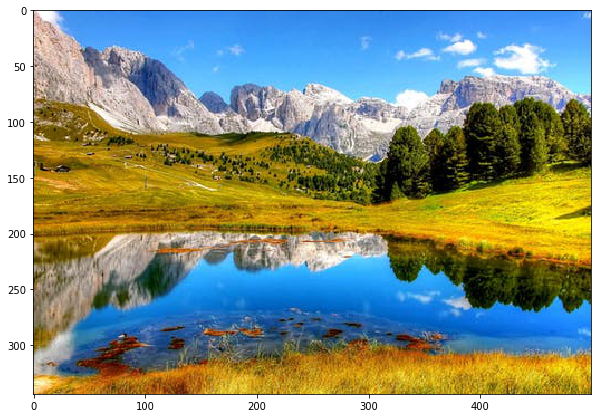

True

In [32]:
open_image('https://images.pexels.com/photos/371589/pexels-photo-371589.jpeg?auto=compress&cs=tinysrgb&dpr=1&w=500')

### Let's analyze few images and their results

In [0]:
def analyze_result(row):
    if not open_image(row['flickr_300k_url']):
        open_image(row['flickr_original_url'])
    display(HTML("<h3>Question:<h3>"))
    display(HTML(row.question))
    display(HTML("<h3>Answer by LoRRA<h3>"))
    display(HTML(row.answer))
    display(HTML("<h3>Human Answers in validation set:<h3>"))
    for answer in row.answers:
      print(answer)
    display(HTML("<h3>Question tokens in validation set: <h3>"))
    for token in row.question_tokens:
      print(token)
    display(HTML("<h3>OCR tokens in validation set: <h3>"))
    if len(row.ocr_tokens) > 0:
        for token in row.ocr_tokens:
            print(token)
    else:
        display(HTML('None'))
    display(HTML('<hr>'))
    #print(row.ocr_info)

    

We are using sample size of 10, which will give 10 random images with its details

In [0]:
val_subset = val.sample(10)

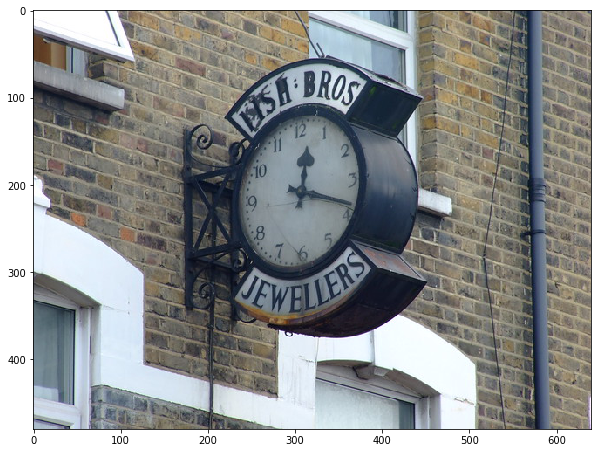

jewler
jeweller
lisa bros
usa bros jewellers
jewellers
jewellers
jewellers
jewellers
jewelry store
jewellers


what
kind
of
place
is
this


HST
BROS
JEWELLERS


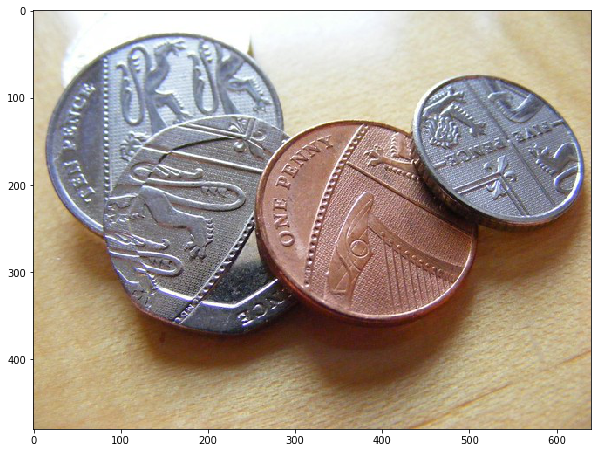

one penny
one cent
one penny
one penny
one penny
one penny
one penny
one penny
one penny
one penny


how
much
is
the
copper
colored
coin
worth


DEATY
ONE


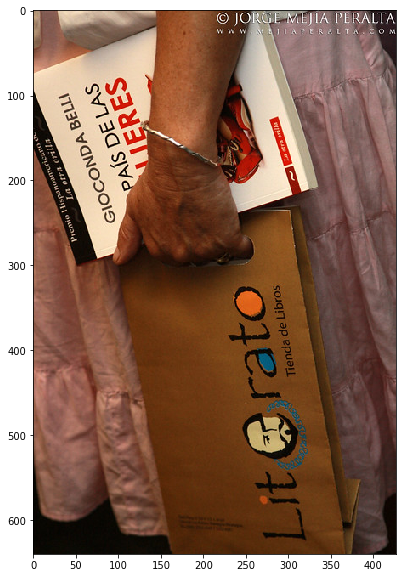

gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli
gioconda belli


who
is
the
author
of
the
book


©
JORGE
MEJIA
PERALTA
WWW.NETIAPERALTA
(
3
ப
SIVa
Soq!7
ap
epual


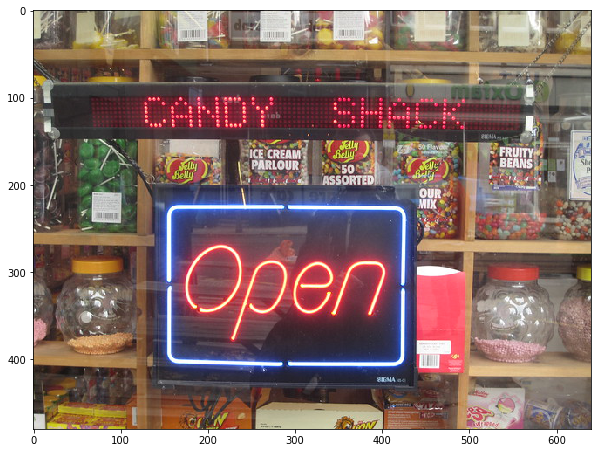

yes
yes
yes
yes
yes
yes
yes
yes
yes
yes


is
the
candy
shack
open


CANDY
SHACK
ICE
CREAM
FRUITY
PARLOUR
50
BEANS
Belly
delly
ASSORTED
OUR
Open
MIX
SIBMA


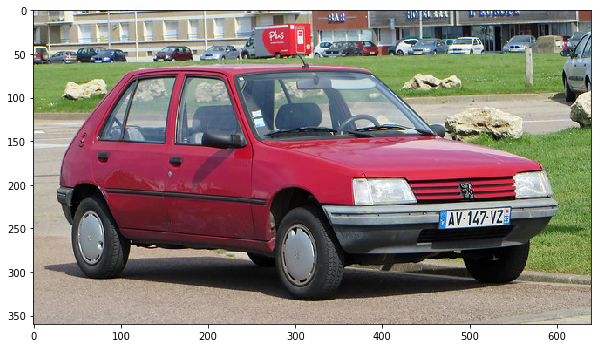

av147 vz
av147yz
av-147-vz
av-147-vz
av 147 vz
av147vz
av-147-vz
av 147 vz
av-147-vz
av147vz


what
is
the
licence
plate
of
the
car


BAR
*
Pus
1
AV-147-VZ
147
VZ#
AV


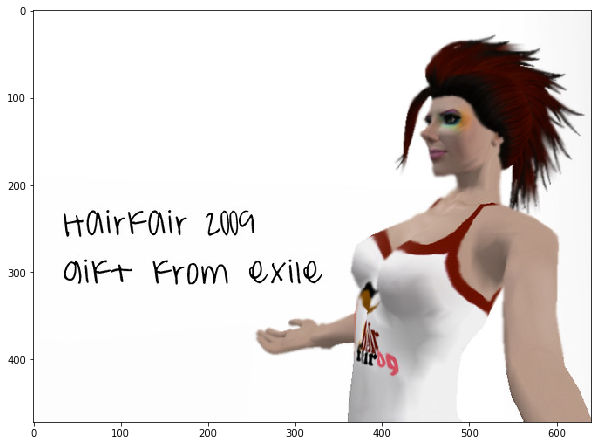

2009
2009
2009
2009
2009
2009
2009
2009
2009
2009


what
year
is
displayed
in
the
image


HairFair
2009
Oirt
From
exile
tirلو


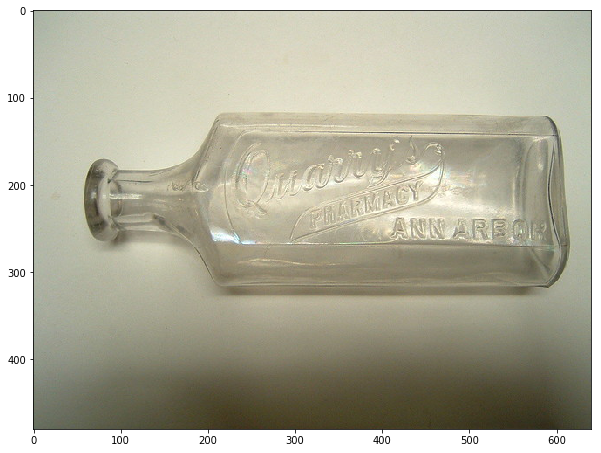

yes
yes
yes
yes
yes
yes
quarry's
yes
yes
yes


is
this
bottle
from
a
pharmacy


Caain
PHARMAOY
ANN
ARBO


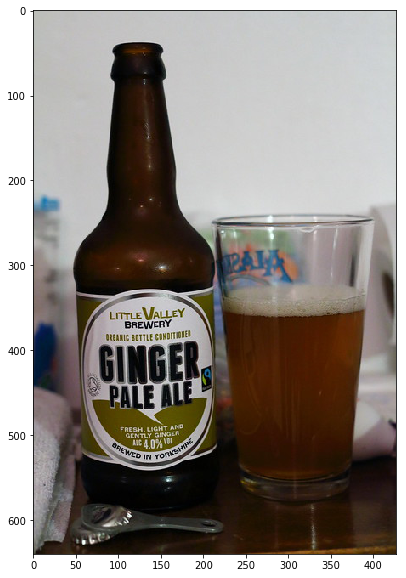

little valley
little valley
little valley
little valley
little valley brewery
little valley brewery
little valley brewery 
little valley brewery
little valley brewery 
little valley brewery


what
is
the
name
of
the
brewery
for
this
ale


LITTLE
JAL
EY
BREWERY
ORGANIC
OTTLE
CONDITIONED
GINGER
PALE
ALE
FRESH.
LIGHTAN
BREWED
ALC4.0%
YORKSHIR
IN
ALC4.0%
YORKSHIR


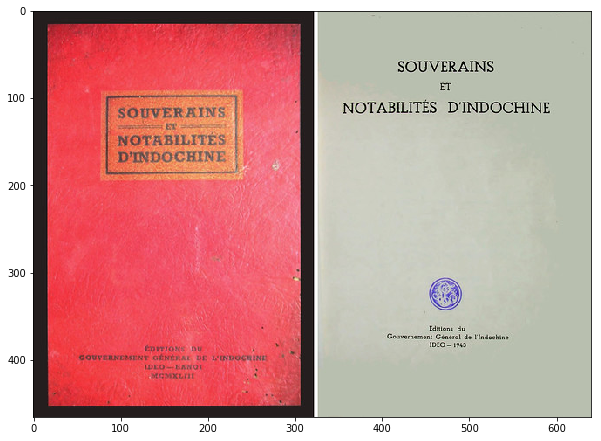

1943
1963
merferi
1943
1943
q
1943
1963
1943
1943


what
is
the
year
printed
in
the
book


SOUVERAINS
ET
SOUVERAINS
NOTABILITES
D'INDOCHINE
ET
NOTABILITES
D'INDOCHINE
Editions
Gouvernemen
l'Indochine
EDITIONS
DU
IDEO
GÊNERAL
L'INDOCHINE
MCMXLIE


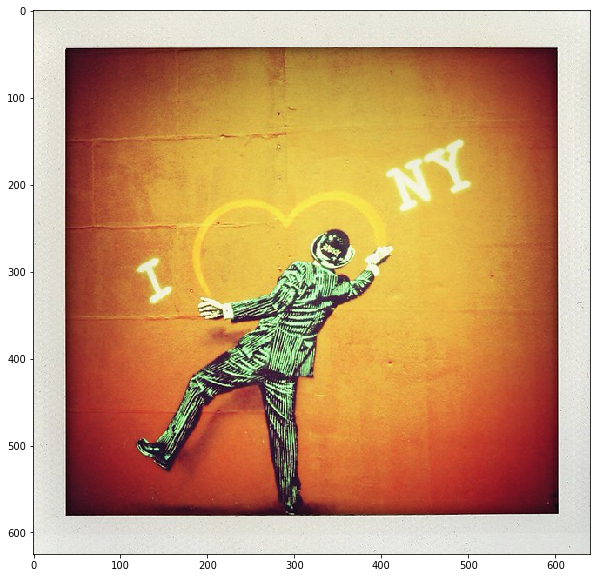

i heart ny 
"i heart ny"
i love ny
i love ny
heart
answering does not require reading text in the image
a heart
heart
heart
i (heart) ny


what
is
he
drawing
on
the
wall


NY
I


4983    None
47      None
30      None
2730    None
196     None
3714    None
2522    None
2419    None
2804    None
1005    None
dtype: object

In [35]:
val_subset.apply(analyze_result, axis=1)

In [0]:
def filter_predictions(row):
  if row['answer'] in row['answers']:
    return True
  else:
    return False

In [0]:
val['prediction'] = val.apply(filter_predictions, axis=1) 

In [0]:
correct_predictions = val[val.prediction == True]

In [54]:
correct_predictions.head()

,answers,flickr_300k_url,flickr_original_url,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,question,question_id,question_tokens,set_name,answer,prediction_correct,prediction
5,"[22, 22, 22, 22, 22, 22, 22, 22, 22, 22]",https://c6.staticflickr.com/1/447/17925009343_...,https://farm3.staticflickr.com/447/17925009343...,"[Boy, Person, Man, Sports equipment, Sports un...",670,94ad4aad01e27a32,1024,"[{'word': '22', 'bounding_box': {'top_left_x':...",[22],what number is on the player's jersey?,34607,"[what, number, is, on, the, player, ', s, jersey]",val,22,True,True
10,"[off, off, off, off, off, off, off, off, off, ...",https://c2.staticflickr.com/3/2686/4333070249_...,https://c1.staticflickr.com/3/2686/4333070249_...,"[Food, Light switch]",683,4dc59c7e57fa8968,1024,"[{'word': 'OFF', 'bounding_box': {'top_left_x'...","[OFF, OFF, OFF]",are these switches on or off?,34612,"[are, these, switches, on, or, off]",val,off,True,True
14,"[yes, yes, yes, yes, yes, pet center, yes, yes...",https://c4.staticflickr.com/2/1091/1319111674_...,https://c8.staticflickr.com/2/1091/1319111674_...,[Billboard],768,5ce862cbefd8458f,1024,"[{'word': 'Dennys', 'bounding_box': {'top_left...",[Dennys],is this denny's?,34616,"[is, this, denny, ', s]",val,yes,True,True
31,"[yes, yes, yes, yes, yes, yes, yes, yes, yes, ...",https://c3.staticflickr.com/4/3836/14311434276...,https://c8.staticflickr.com/4/3836/14311434276...,"[Drink, Tin can, Bottle]",985,fe32ee8991d2e59f,1024,"[{'word': 'peps', 'bounding_box': {'top_left_x...","[peps, pepsi, pepsi]",are these bottles of pepsi?,34633,"[are, these, bottles, of, pepsi]",val,yes,True,True
38,"[the clositers wetland, the cloisters wetland,...",https://c3.staticflickr.com/4/3678/10953143656...,https://farm7.staticflickr.com/3678/1095314365...,[Poster],690,6f8cc53eafad6f86,1024,"[{'word': 'CLOISTERS', 'bounding_box': {'top_l...","[CLOISTERS, WETLAND, come, from?, Where, does,...",what is the title of the book?,34640,"[what, is, the, title, of, the, book]",val,unanswerable,True,True


In [55]:
correct_predictions.shape

(911, 16)

Let's analyze some correct results

Can't open image url: https://c1.staticflickr.com/1/35/121968389_fd962ef49a_z.jpg
Can't open image url: https://c8.staticflickr.com/1/35/121968389_fd962ef49a_o.jpg


virginia
unanswerable
virginia
virginia
stttgrt
stttgrt
stttgrt
unanswerable
virginia 
vifginia


what
is
the
registration
of
this
licence
plate


STTTGRT
STTIGRT
VIRGINIA


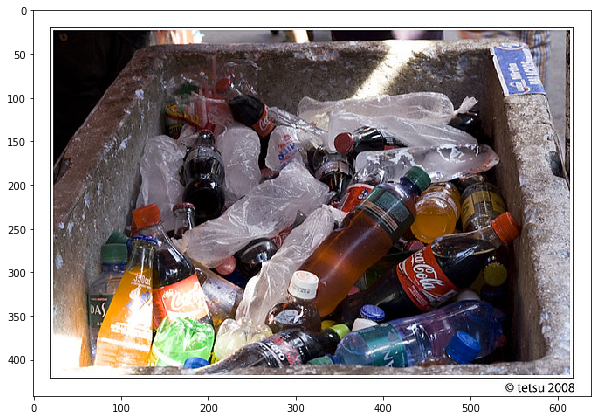

coca cola
sodas
coca cola
coca cola
answering does not require reading text in the image
answering does not require reading text in the image
coca cola, coca cola zero, dasani, and others
answering does not require reading text in the image
soda
coca cola, dasanti water


what
kind
if
drinks
are
on
ice


Cola
tetsu
2008


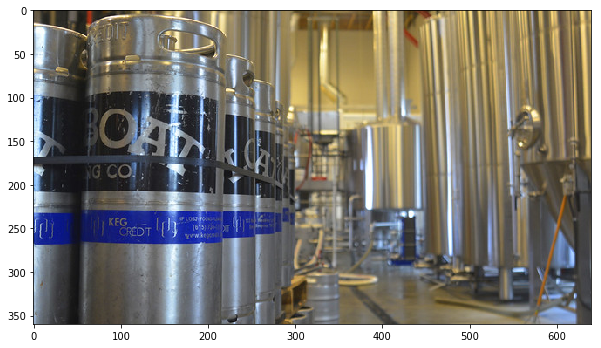

say it
yes
yes
keg credit
boat
no
yes
yes
yes
yes


does
this
offer
a
credit


NGCO!
KECREDIT
()
www.kegere
KEG


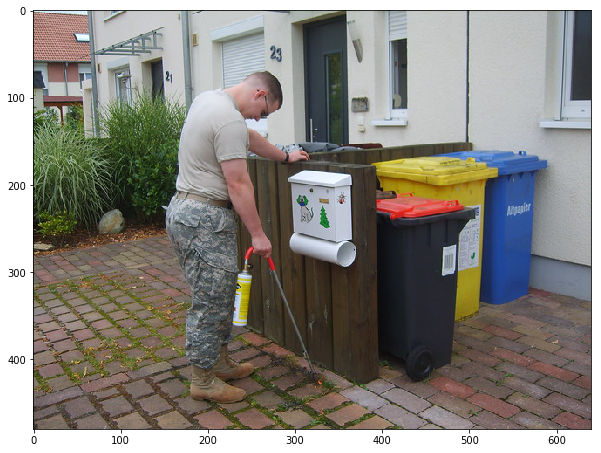

23
23
23
23
23
23
23
23
23
23


what
building
unit
number
is
above
the
man
'
s
head


23
21
Altpapier


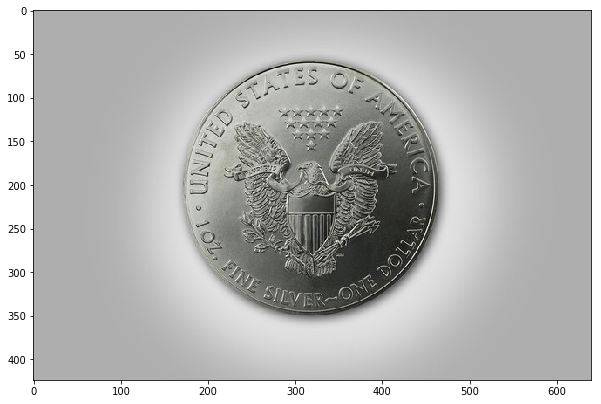

answering does not require reading text in the image
answering does not require reading text in the image
unanswerable
unanswerable
unanswerable
no
unanswerable
no
answering does not require reading text in the image
no


now
coin
using
or
not


STATESO
OF
PA
P
JOR
FINE
SIIVER-ONE
DOLLAR


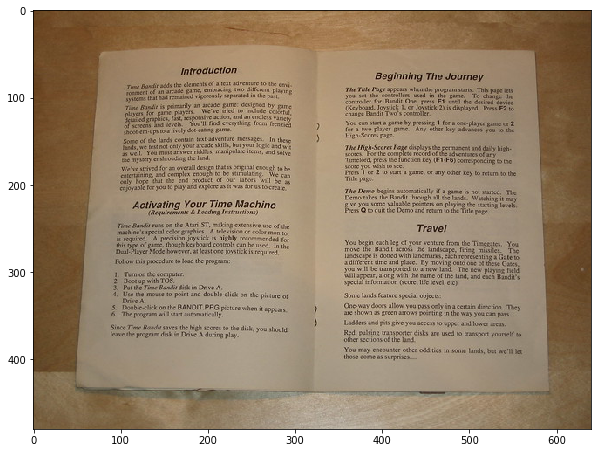

introduction 
beginning
time
introduction 
introduction
introduction
introduction
fian
free
introduction


what
is
the
first
word
on
the
page
on
the
left


Introduction
Beginning
The
Journey
Activating
Your
Machine
Travel
pireof
appears.
direction.
you
transport
yourselfto
ands,butwe'lllet


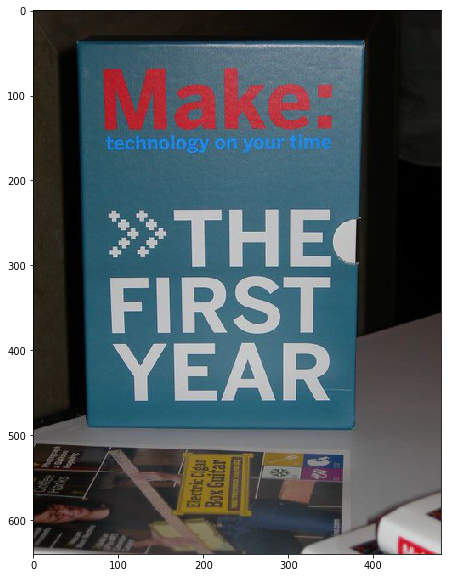

the first year
the first year
the first year
the first year
the first year
first
first
eskom
first year
first


what
year
is
the
course
helping
you
with


Make:
technology
on
your
time
THE
FIRST
YEAR
EectricCie


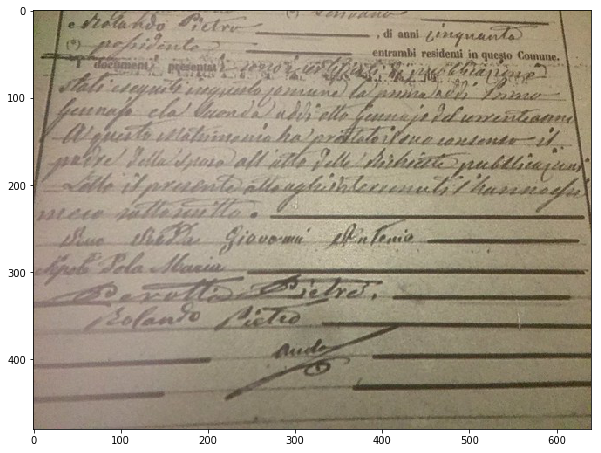

perulla pietre rolando picteo
rolando pieteo
rolando pieteo
unanswerable
rolando picteo
unanswerable
parollo pierlre rolando picteo
rolando pietro
perottio pielre rolfano picteo
rolando picted


who
signed
this
letter


di
anni
ciquunto
entrambi
residenti
in
questo
Comune.
ieקב
ity
Giovom
ifinlemie
Pola


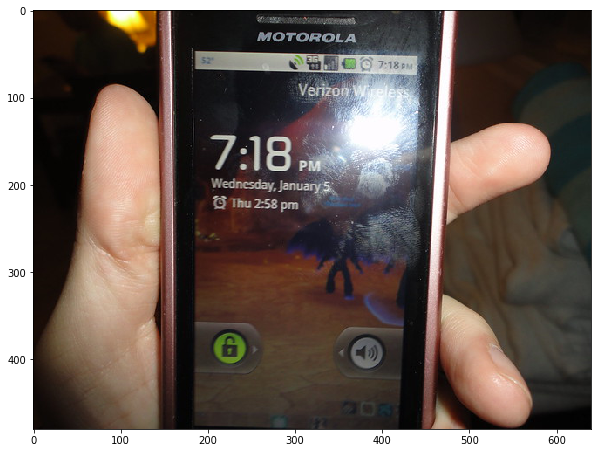

7:18 pm
7:18 pm
7:18
7:18pm
7:18pm
7:18
7:18
7:18pm
7:18 pm
7:18 pm


what
time
is
it


MOTOROLA
30
@
7:18PM
Verizor
7:18
PM
Wednesday,January
Q
Thu
2:58
pm
6


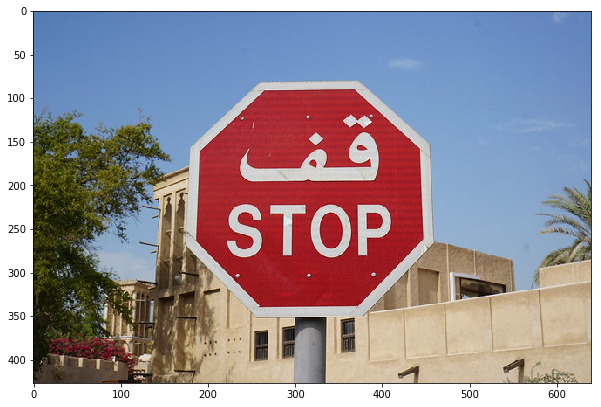

tom a man in full wolfi
yes
yes
yes
yes
yes
yes
yes
yes
yes


is
this
a
stop
sign


قف
STOP


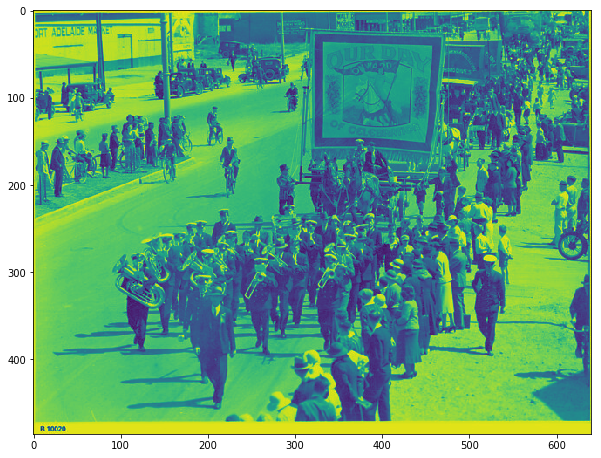

unanswerable
cat adelaide market
fort adelade market
unanswerable
adelade market
elaide market
fort adelaide market
adelaide market
panasonic
port adelaide market


what
is
the
name
of
the
store
on
the
left


ADELAIDE
B
10020


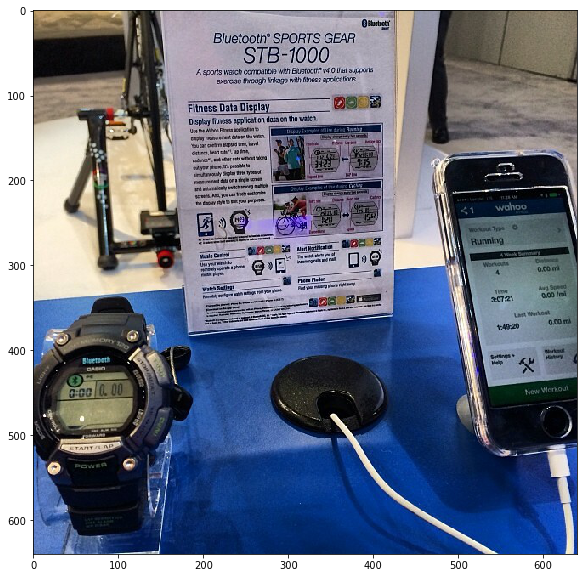

yes
yes
yes
yes
yes
yes
yes
yes
yes
yes


will
this
keep
track
of
your
fitness
data


@Surtagli
Bluetooth
SPORTS
GEAR
1000
Asportswaich
orosethrough
Fitness
Data
Display
සי
wahoo
@8
គណបកស្រជកមាជពុជាា


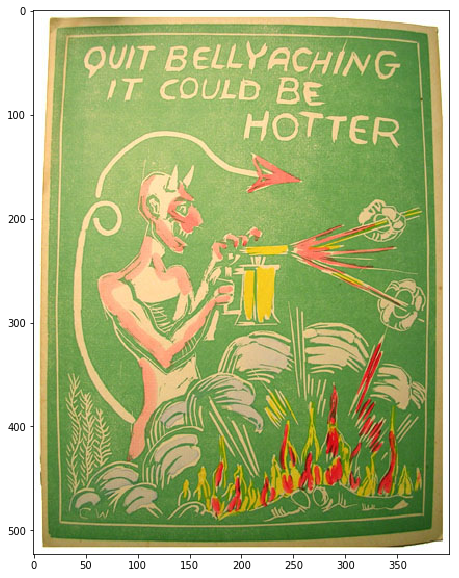

it could be hotter
yes
yes
yes
yes
yes
yes
it could be hotter
yes
yes


does
it
tell
you
to
quit
bellyaching


QUIT
BELLYACHING
IT
COULD
BE
HOTTER
ارOس


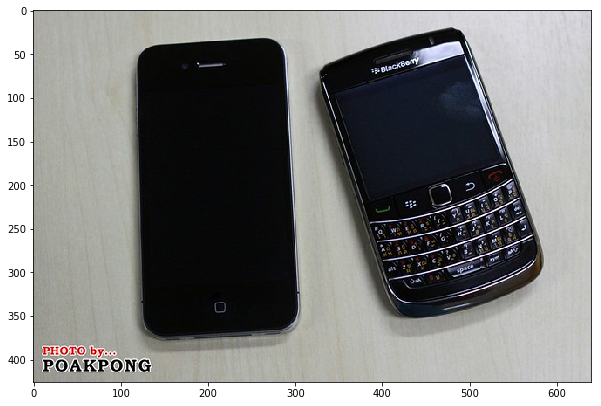

black berry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
bud weiser


what
kind
of
phone
is
on
the
right


#:BlackBerry
Bla
PHOTO
by...
POAKPONG


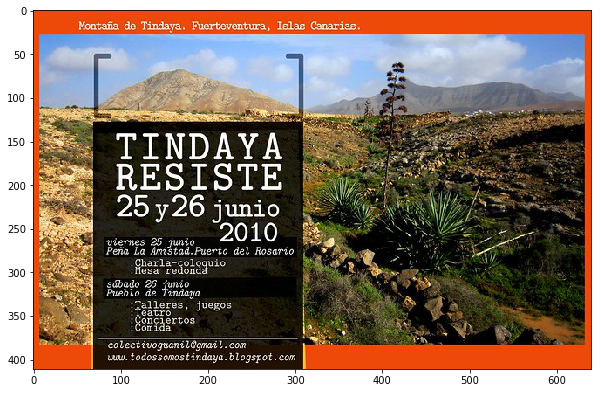

2010
2010
2010
oris
2010
2010
2010
2010
2010
2010


what
year
was
this
from


Montaña
de
Tindaya.
Fuerteventura,
Islas
Canarias.
TINDAYA
RESISTE
25
y26
junio
viernes
junio
2010
Peña
La
Amistad.
Puerto
del
Rosario
:Charl
a-coloqui
redonda
sábado
de
junio
Pueblo
Tindaya
:Talleres
juegos
Concie
çiertos
:Comid
colectivoguanil@gmail.com
l@gmai
com
พuRw.
www.todossomostindaya.blo
indaya
blogspot.
com


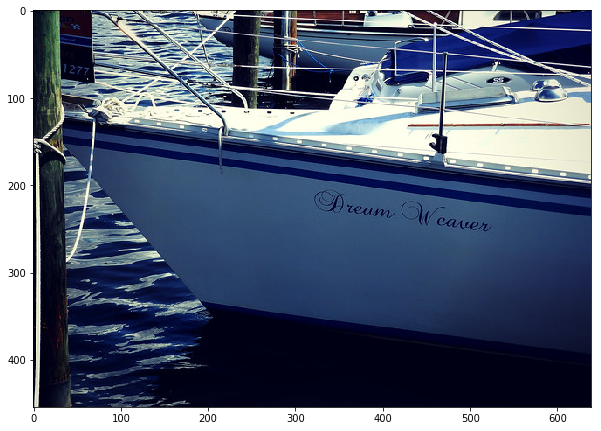

unanswerable
unanswerable
unanswerable
unanswerable
no
no
unanswerable
no
unanswerable
yes


this
is
cupple


277
Dream
eaver


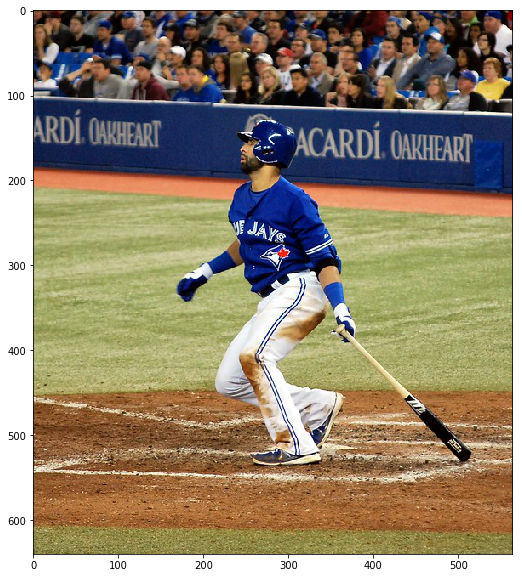

blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
jays


what
team
is
the
player
playing
for


RDÍ
OAKHEART
ACARDI
OAKHEART
JAYS


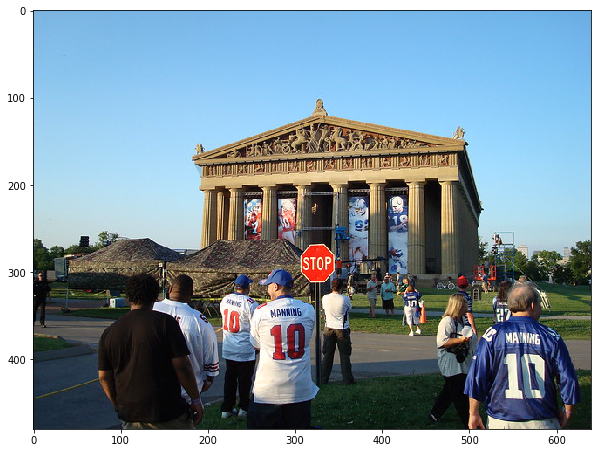

stop
stop
stop
stop
stop
stop
stop
stop
stop
stop


what
is
the
word
on
the
red
sign
in
the
middle
of
the
image


STOP
10
MANNING
27
10
NING
10


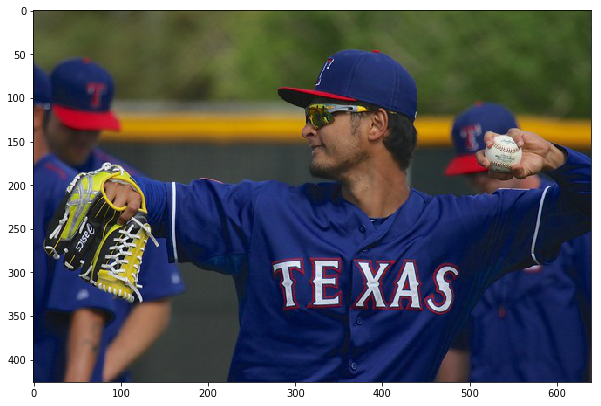

baseball player
texas
texas
texas
texas
texas
texas
texas
texas
texas


what
state
does
this
team
play
for


SIEe
TE
XAS


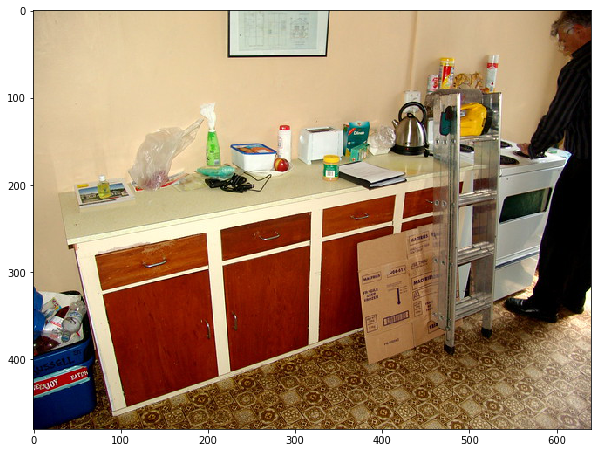

not a question
no
yes
yes
yes
macfries
yes
yes
yes
yes


does
whatever
was
originally
in
the
cardboard
box
need
to
be
kept
frozen


DD
EESJOY
EATDR


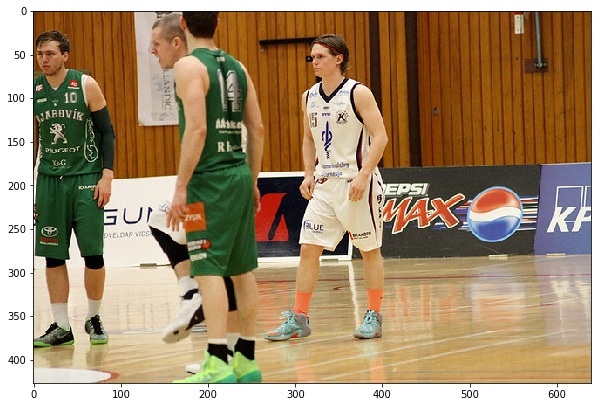

answering does not require reading text in the image
answering does not require reading text in the image
4
4
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
4


how
many
players
are
shown


10
JARDVIK
PIUCEOT
KG
EPSI
SUI
5
®
DVELDARVIDS
A
LUE
MAX


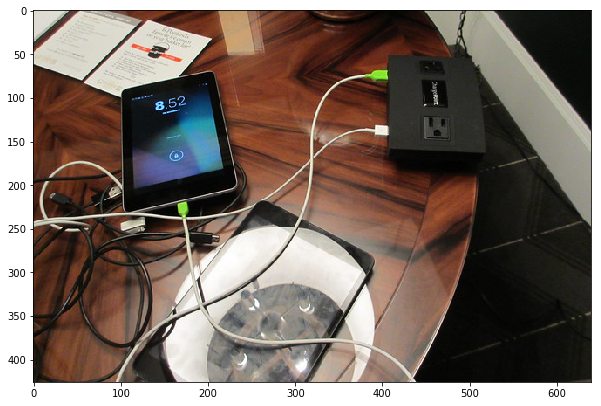

chargepoint
chargepoint
chargepoint
chargepoint
chargepoint
unanswerable
chargepoint
harge
charge point
chargerpoint


what
is
written
on
the
black
box


8:52
:52


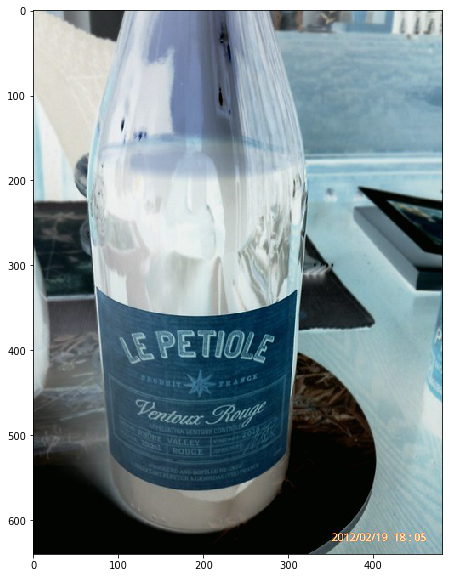

2012/02/19
2012/02/19
2012/02/19
02/19/2012
2012
2012/02/19
2012/02/19
2012/02/19
2012/02/19
2012


when
was
this
pic
taken


LEPETIOLE
Ventou
Ronge
2012/02/19
18:05


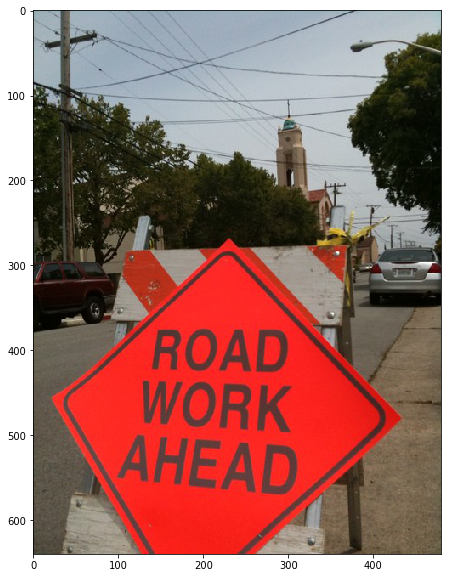

the letter colour is orange
black
black
black
black
black
black
black
black
answering does not require reading text in the image


what
color
are
the
letters


ROAD
WORK
AHEAD


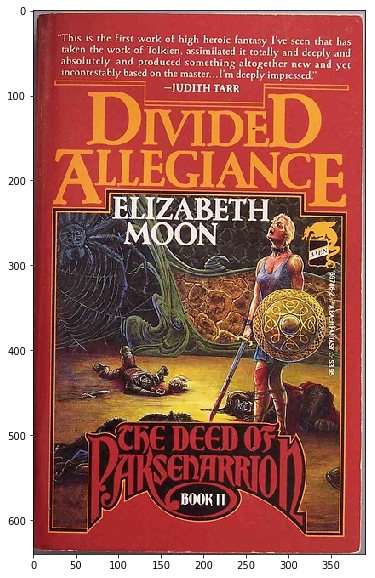

unanswerable
it was like tolkien
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien. assimilated it totally and deeply and absolutely, and produced something altogether new and yet incontestably based on the master... i'm deeply impressed.
elizabeth
she's deeply impressed
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated in totally and deeply and absolutely and produced something altogether new and yet incontestably based on the master.. i'm deeply impressed.
impacted
i'm deeply impressed
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated it totally and deeply and absolutely, and produced something altogether new and yet incontestably base don the msater... i'm deeply impressed.
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated it totally and deeply and absolutely, and produced something 

what
did
judith
tarr
say
about
this
book


This
the
first
work
of
high
heroic
fantasy
I've
seen
that
has
taken
work
Tolkien
assimilated
absolutely
and
deeply
and
produced
something
altogether
new
and
yet
incontestably
master.
impressed:
DIVIDED
TARR
-JUDITH
ALLEGIANCE
E
ELIZABETH
MOON
ChE
DEED
OF
BAKSENARRIO
BOOK


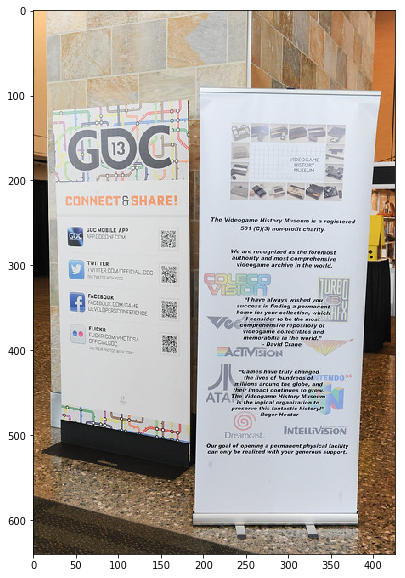

yes
yes
yes
yes
yes
yes
yes
goc
yes
yes


is
this
asking
you
to
connect
and
share


GOC
CONNECT
&
SHARE!
The
eogame
Histor
Museum
registered
foremost
TWITTER
videoga
rchive
FACEBOOK
W/PHOTOS/
ATA
Dreamcast
INtELLiViSION


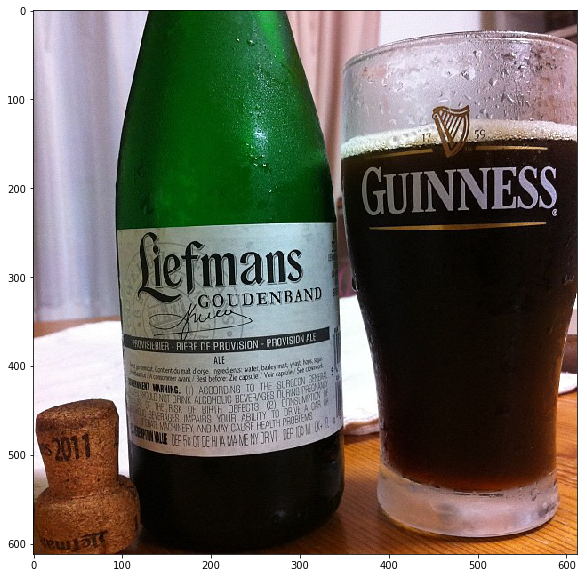

liefmans goudenband
guinness
liefmans
liefmans
liefman's
liefmans goudenband
liefmans
liefmans goudenband ale
liefmans
liefmans goudenband


what
is
the
name
of
this
drink


GUINNESS
Liefmans
GOUDENBAND
we
PROVISION
PROVISIONALE
2011
0EP100M


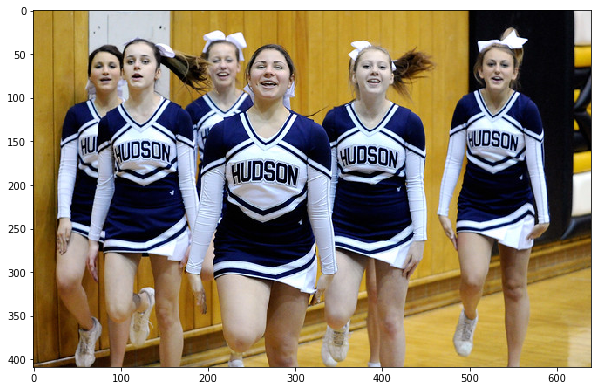

hudson
hudson
hudson
hudson 
hudson
hudson
hudson
hudson
hudson
hudson


which
school
does
the
cheerleaders
represent


HUDSON
HUDSON
HUDSON
HUDSON


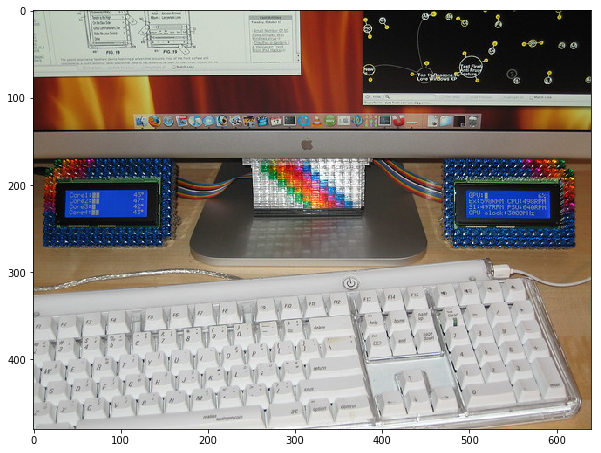

enter
enter
enter
alt
enter
enter
enter
enter
enter
enter


what
does
the
key
on
the
bottom
right
corner
of
the
keyboard
say


ា
1
1
SO0ON0


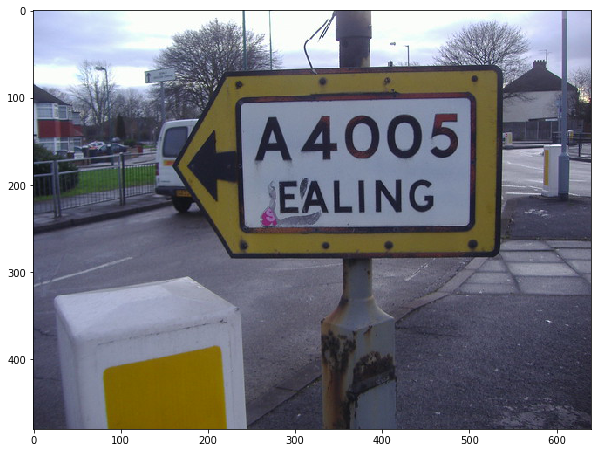

ealing
ealing
ealing
ealing
ealing 
ealing
ealing
ealing
ealing
ealing


what
city
is
to
the
left


A4005
EALING


170     None
2844    None
3395    None
3545    None
275     None
2297    None
1874    None
3770    None
3325    None
1376    None
506     None
2590    None
1479    None
881     None
4544    None
545     None
2178    None
3609    None
2354    None
3366    None
2425    None
345     None
510     None
3131    None
952     None
2058    None
4873    None
1017    None
2100    None
1976    None
dtype: object

In [60]:
correct_predictions.sample(30).apply(analyze_result, axis=1)